In [2]:
# define logging and working directory
from ProjectRoot import change_wd_to_project_root
change_wd_to_project_root()
from src.utils.notebook_imports import *
from pyforest import *
from src.utils.Tensorflow_helper import choose_gpu_by_id
from tensorflow.keras.utils import plot_model

# define GPU id to use
GPU_IDS = '0,1'
GPUS = choose_gpu_by_id(GPU_IDS)
print(GPUS)

# jupyter magic config
%matplotlib inline
%reload_ext autoreload
%autoreload 2

# import helpers
from src.utils.utils_io import Console_and_file_logger, init_config
from src.visualization.Visualize import show_2D_or_3D
from src.data.Dataset import get_img_msk_files_from_split_dir, load_acdc_files, get_train_data_from_df, get_trainings_files
from src.data.Generators import DataGenerator, get_samples
#from src.utils.unet_3d_metrics import weighted_dice_coefficient_loss
from src.utils.KerasCallbacks import get_callbacks
import src.utils.my_metrics as metr
import cv2
from tensorflow.keras.losses import mse
import src.utils.my_metrics as metr


# define experiment name for report, model and log paths + filenames
#EXPERIMENT = '2D/tf2/acdc/combined/2D_NOrot90_dfsplit_6_224_11_fold1'
EXPERIMENT = '3D/ax_sax/register_sax_to_ax/temp'
now = datetime.datetime.now()
# image params, change for different input data/architecture
ARCHITECTURE = '3D' # 2D
# path params
DATASET = 'GCN'  # 'acdc' # or 'gcn'
TRAIN_PATH = 'data/raw/{}/{}/train/'.format(DATASET, ARCHITECTURE)
VAL_PATH = 'data/raw/{}/{}/val/'.format(DATASET, ARCHITECTURE)
TEST_PATH = 'data/raw/{}/{}/val/'.format(DATASET, ARCHITECTURE)
#DF_DATA_PATH = 'data/raw/{}/{}/df_kfold.csv'.format(DATASET, ARCHITECTURE)
#DF_DATA_PATH = 'data/raw/miccai2020/2d_dataset.csv' # miccai special case
DATA_PATH = '/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/SAX_3D_ISO/'
FOLD = 0

MODEL_PATH = os.path.join('models', EXPERIMENT, str(now.strftime("%Y-%m-%d_%H_%M")))
TENSORBOARD_LOG_DIR = os.path.join('reports/tensorboard_logs', EXPERIMENT,str(now.strftime("%Y-%m-%d_%H_%M")))
CONFIG_PATH = os.path.join('reports/configs/',EXPERIMENT,str(now.strftime("%Y-%m-%d_%H_%M")))
HISTORY_PATH = os.path.join('reports/history/',EXPERIMENT,str(now.strftime("%Y-%m-%d_%H_%M")))

#DIM = [32,64, 64] # network input params for spacing of 5
DIM = [80, 224, 224]
DEPTH = 5 # number of down-/upsampling blocks
FILTERS = 24 # initial number of filters, will be doubled after each downsampling block
#SPACING = [8,1.1, 1,1] # used by sitk, order will be reversed to have the same shape as dim
SPACING = [1.5,1.5, 1.5] # if resample, resample to this spacing
M_POOL = [2, 2, 2]# used for downsampling and upsampling
F_SIZE = [3, 3, 3] # conv filter size
IMG_CHANNELS = 1
MASK_VALUES = [0, 1, 2, 3]  #channel order: Background, RV, MYO, LV
MASK_CLASSES = len(MASK_VALUES) # no of labels
BORDER_MODE = cv2.BORDER_REFLECT_101
IMG_INTERPOLATION = cv2.INTER_LINEAR
MSK_INTERPOLATION = cv2.INTER_NEAREST
AUGMENT = False
SHUFFLE = True
AUGMENT_GRID = False
RESAMPLE = False
SCALER = 'MinMax' # MinMax Standard or Robust

# training params
#GENERATOR_WORKER = 6# if not set, use batchsize
SEED = 42 # define a seed for the generator shuffle
BATCHSIZE = 2 # 32, 64, 24, 16, 1 for 3D use: 8
INITIAL_EPOCH = 0 # change this to continue training
EPOCHS = 300 # define a maximum numbers of epochs
EPOCHS_BETWEEN_CHECKPOINTS = 5
MONITOR_FUNCTION = 'loss'
MONITOR_MODE = 'min'
SAVE_MODEL_FUNCTION = 'loss'
SAVE_MODEL_MODE = 'min'
BN_FIRST = False # decide if BN between Conv and activation or afterwards
BATCH_NORMALISATION = True # apply BN or not
USE_UPSAMPLE = True # otherwise use transpose
PAD = 'same' # padding strategy
KERNEL_INIT = 'he_normal' # conv weight initialisation
OPTIMIZER = 'adam' # Adam, Adagrad, RMSprop, Adadelta,  # https://keras.io/optimizers/
ACTIVATION = 'elu' # tf.keras.layers.LeakyReLU(), relu, any non linear activation function
LEARNING_RATE = 1e-4 # start with a huge lr to converge fast
DECAY_FACTOR = 0.3 # Define a learning rate decay for the ReduceLROnPlateau callback
MIN_LR = 1e-10 # smaller lr does not improve the model
DROPOUT_min = 0.3 # lower dropout at the shallow layers
DROPOUT_max = 0.5 # higher dropout at the deep layers

metrics = [
    metr.dice_coef_labels,
    metr.dice_coef_myo,
    metr.dice_coef_lv,
    metr.dice_coef_rv
]

#MASKING_VALUES = [2]
#MASKING_IMAGE = False

LOSS_FUNCTION = metr.bce_dice_loss
#LOSS_FUNCTION = metr.jaccard_distance_loss
#LOSS_FUNCTION = metr.bce_dice_jac_loss

Console_and_file_logger(EXPERIMENT, logging.INFO)

# Define a config for param injection,
# save a serialized version, 
# make sure all paths exist
config = init_config(config=locals(), save=True)
print(config)

search for root_dir and set working directory
Working directory set to: /mnt/data/git/cardio
['/gpu:0', '/gpu:1']


Using TensorFlow backend.
2020-07-08 12:39:03,439 INFO -------------------- Start --------------------
2020-07-08 12:39:03,439 INFO Working directory: /mnt/data/git/cardio.
2020-07-08 12:39:03,440 INFO Log file: ./logs/3D/ax_sax/register_sax_to_ax/temp.log
2020-07-08 12:39:03,440 INFO Log level for console: INFO


{'GPU_IDS': '0,1', 'GPUS': ['/gpu:0', '/gpu:1'], 'EXPERIMENT': '3D/ax_sax/register_sax_to_ax/temp', 'ARCHITECTURE': '3D', 'DATASET': 'GCN', 'TRAIN_PATH': 'data/raw/GCN/3D/train/', 'VAL_PATH': 'data/raw/GCN/3D/val/', 'TEST_PATH': 'data/raw/GCN/3D/val/', 'DATA_PATH': '/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/SAX_3D_ISO/', 'FOLD': 0, 'MODEL_PATH': 'models/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_12_39', 'TENSORBOARD_LOG_DIR': 'reports/tensorboard_logs/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_12_39', 'CONFIG_PATH': 'reports/configs/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_12_39', 'HISTORY_PATH': 'reports/history/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_12_39', 'DIM': [80, 224, 224], 'DEPTH': 5, 'FILTERS': 24, 'SPACING': [1.5, 1.5, 1.5], 'M_POOL': [2, 2, 2], 'F_SIZE': [3, 3, 3], 'IMG_CHANNELS': 1, 'MASK_VALUES': [0, 1, 2, 3], 'MASK_CLASSES': 4, 'BORDER_MODE': 4, 'IMG_INTERPOLATION': 1, 'MSK_INTERPOLATION': 0, 'AUGMENT': False, 'SHUFFLE': True, 'AUGMENT_GRID': Fals

In [4]:
# Load AX slices

from src.data.Generators import MotionDataGenerator, CycleMotionDataGenerator
info = {}

x_train_sax, y_train_sax, x_val_sax, y_val_sax =  get_trainings_files(data_path=DATA_PATH,fold=FOLD)
config.update(info)
config = init_config(config)

logging.info('x_train files: {}, y_train files: {}'.format(len(x_train_sax), len(y_train_sax)))
logging.info('x_val files: {}, y_val files: {}'.format(len(x_val_sax), len(y_val_sax)))

2020-07-08 12:39:29,930 INFO Found 162 images/masks in /mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/SAX_3D_ISO/
2020-07-08 12:39:29,935 INFO Selected 120 of 162 files with 64 of 86 patients for training fold 0
2020-07-08 12:39:29,936 INFO x_train files: 120, y_train files: 120
2020-07-08 12:39:29,937 INFO x_val files: 42, y_val files: 42


In [5]:
# load SAX slices
DATA_PATH_SAX = DATA_PATH.replace('SAX_3D_ISO', 'SAX_to_AX_3D_ISO_SHIFT')
#DATA_PATH_SAX = 'data/interim/sax_ax_3d_thres_50_max/ax_to_sax'
x_train_ax, y_train_ax, x_val_ax, y_val_ax =  get_trainings_files(data_path=DATA_PATH_SAX,fold=FOLD)
config.update(info)
config = init_config(config)

logging.info('x_train files: {}, y_train files: {}'.format(len(x_train_ax), len(y_train_ax)))
logging.info('x_val files: {}, y_val files: {}'.format(len(x_val_ax), len(y_val_ax)))

2020-07-08 12:39:30,393 INFO Found 162 images/masks in /mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/SAX_to_AX_3D_ISO_SHIFT/
2020-07-08 12:39:30,399 INFO Selected 120 of 162 files with 64 of 86 patients for training fold 0
2020-07-08 12:39:30,400 INFO x_train files: 120, y_train files: 120
2020-07-08 12:39:30,401 INFO x_val files: 42, y_val files: 42


In [6]:
print('ax examples: {}'.format(x_train_ax[:2]))
print('sax_examples: {}'.format(x_train_sax[:2]))

ax examples: ['/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/SAX_to_AX_3D_ISO_SHIFT/0000-0PTV75MP_2005-06-27_ED_img.nrrd', '/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/SAX_to_AX_3D_ISO_SHIFT/0000-0PTV75MP_2005-06-27_ES_img.nrrd']
sax_examples: ['/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/SAX_3D_ISO/0000-0PTV75MP_2005-06-27_ED_img.nrrd', '/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/SAX_3D_ISO/0000-0PTV75MP_2005-06-27_ES_img.nrrd']


In [7]:
# filter files by name
#x_train_ax = [x for x in x_train_ax if 'CT8YR38C_2005' in x]
print(len(x_train_ax))
#x_train_sax = [x for x in x_train_sax if 'CT8YR38C_2005' in x]

120


In [8]:
Console_and_file_logger('temp', logging.INFO)
#config['BATCHSIZE'] = # 64 debugging
batch_generator = MotionDataGenerator(x_train_sax, x_train_ax, config)
valid_generator = MotionDataGenerator(x_val_sax, x_val_ax, config)

2020-07-08 12:39:34,353 INFO -------------------- Start --------------------
2020-07-08 12:39:34,367 INFO Working directory: /mnt/data/git/cardio.
2020-07-08 12:39:34,367 INFO Log file: ./logs/temp.log
2020-07-08 12:39:34,368 INFO Log level for console: INFO
2020-07-08 12:39:34,368 INFO Create DataGenerator
2020-07-08 12:39:34,369 INFO Datagenerator created with: 
 shape: [80, 224, 224]
 spacing: [1.5, 1.5, 1.5]
 batchsize: 2
 Scaler: MinMax
 Images: 120 
 Augment_grid: False 
 Thread workers: 2
2020-07-08 12:39:34,369 INFO No augmentation
2020-07-08 12:39:34,370 INFO Create DataGenerator
2020-07-08 12:39:34,370 INFO Datagenerator created with: 
 shape: [80, 224, 224]
 spacing: [1.5, 1.5, 1.5]
 batchsize: 2
 Scaler: MinMax
 Images: 42 
 Augment_grid: False 
 Thread workers: 2
2020-07-08 12:39:34,371 INFO No augmentation


In [7]:
# Select batch generator output
@interact
def select_batch(batch = (0,len(batch_generator), 1)):
    global x, y
    input_ , output_ = batch_generator.__getitem__(batch)
    x = input_[0]
    y = output_[0]
    logging.info(x.shape)
    logging.info(y.shape)


interactive(children=(IntSlider(value=30, description='batch', max=60), Output()), _dom_classes=('widget-inter…

In [8]:
@interact
def select_image_in_batch(im = (0,x.shape[0]- 1, 1),slice_by=(1,6)):
    
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.DEBUG)
    #show_2D_or_3D(x[im][...,0][::5])
    logging.info('AX: {}'.format(x[im].shape))
    show_2D_or_3D(x[im][...,0][::slice_by])
    plt.savefig('reports/images/temp/ax.pdf')
    plt.show()
    logging.info('SAXtoAX: {}'.format(y[im].shape))
    show_2D_or_3D(y[im][...,0][::slice_by])
    plt.savefig('reports/images/temp/sax.pdf')
    plt.show()
    

interactive(children=(IntSlider(value=0, description='im', max=1), IntSlider(value=3, description='slice_by', …

In [9]:
import src.models.SpatialTransformer as st
from src.models.SpatialTransformer import create_affine_transformer, create_affine_cycle_transformer

using tensorflow, need to monkey patch
tf.python.backend.slice overwritten by monkey patch


In [10]:
model = st.create_affine_transformer(config=config, metrics=metrics)

2020-07-08 09:24:56,355 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')


Number of devices: 2
(None, 80, 224, 224, 1)


2020-07-08 09:24:56,737 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 09:24:56,748 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 09:24:56,789 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 09:24:56,796 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 09:24:56,830 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 09:24:56,837 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 09:24:56,876 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:

In [11]:
model.summary()

Model: "affine_transformer"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 80, 224, 224 0                                            
__________________________________________________________________________________________________
conv3d (Conv3D)                 (None, 80, 224, 224, 672         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 80, 224, 224, 96          conv3d[0][0]                     
__________________________________________________________________________________________________
dropout (Dropout)               (None, 80, 224, 224, 0           batch_normalization[0][0]        
_________________________________________________________________________________

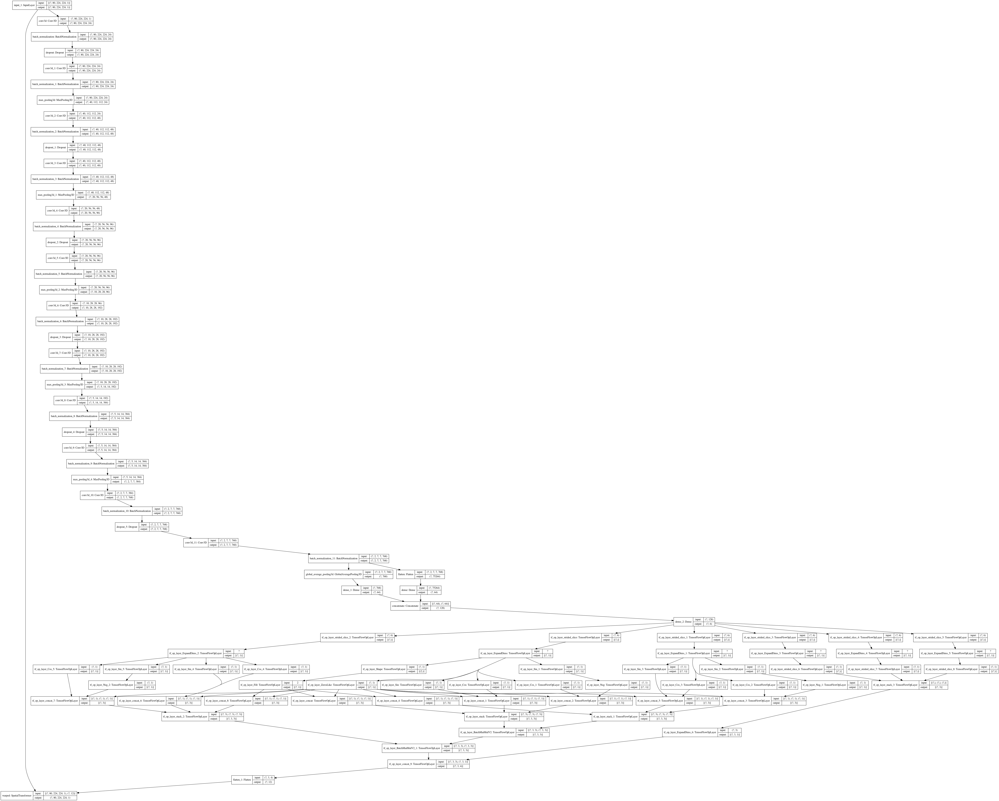

In [12]:
plot_model(model, to_file='data/temp/graph.png',show_shapes=True)

In [14]:
@interact
def select_image_in_batch(im = (0,x.shape[0]- 1, 1),slice_by=(1,6)):
    global m
    temp = x[im]
    temp_ = y[im]
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.INFO)
    logging.info('prediction on: {}'.format(temp.shape))
    show_2D_or_3D(temp[::slice_by])
    plt.show()
    pred, m = model.predict(np.expand_dims(temp,axis=0))                     
    logging.info('rotated by the model: {}'.format(pred[0].shape))
    show_2D_or_3D(pred[0][::slice_by])
    plt.show()
    logging.info('target (SAX): {}'.format(temp_.shape))
    show_2D_or_3D(temp_[::slice_by])
    plt.show()
    logging.info('MSE: {}'.format(mse(pred[0], temp_).numpy().mean()))
    logging.info('MSE center cube: {}'.format(metr.front_mse(pred[0], temp_).numpy().mean()))
    try:
        print(np.reshape(m[0],(3,4)))
    except Exception as e:
        pass

interactive(children=(IntSlider(value=3, description='im', max=7), IntSlider(value=3, description='slice_by', …

In [13]:
# second trainings step, 
# finetune the model with the first n slices to enforce the z translation 
# and crop each slice by a margin to ignore the big error of the black edges due to the rotation focus on the image itself
from src.models.Unets import get_optimizer
model.compile(optimizer=get_optimizer(config, 'finetune'),
                      loss={'warped': metr.front_mse },
                      loss_weights={'warped': 1.0})

In [ ]:
# train one model
initial_epoch = 0
# training

# start a new main process for this training to free gpu memory afterwards
logging.info('Fit model, start trainings process')
# fit model with trainingsgenerator
results = model.fit(
    x=batch_generator,
    validation_data=valid_generator,
    validation_steps=2,
    epochs=200,
    callbacks = get_callbacks(config),
    steps_per_epoch = len(batch_generator),
    initial_epoch=initial_epoch,
    max_queue_size=6,
    workers=8,
    #use_multiprocessing=True,
    verbose=1)

2020-07-08 09:55:33,970 INFO Fit model, start trainings process


Epoch 1/200


2020-07-08 09:55:37,363 INFO batch_all_reduce: 54 all-reduces with algorithm = nccl, num_packs = 1
2020-07-08 09:55:41,560 INFO batch_all_reduce: 54 all-reduces with algorithm = nccl, num_packs = 1


 2/60 [>.............................] - ETA: 57s - loss: 0.0779 - warped_loss: 0.0779

2020-07-08 09:55:52,532 WARNING Callbacks method `on_train_batch_end` is slow compared to the batch time (batch time: 0.5341s vs `on_train_batch_end` time: 1.4590s). Check your callbacks.


60/60 [==============================] - ETA: 0s - loss: 0.0722 - warped_loss: 0.0722

2020-07-08 09:57:03,150 INFO Saved model to disk: models/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_09_24



Epoch 00001: loss improved from inf to 0.07217, saving model to models/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_09_24/checkpoint.h5
60/60 [==============================] - 76s 1s/step - loss: 0.0722 - warped_loss: 0.0722 - val_loss: 0.0809 - val_warped_loss: 0.0809 - lr: 1.0000e-04
Epoch 2/200
60/60 [==============================] - ETA: 0s - loss: 0.0715 - warped_loss: 0.0715
Epoch 00002: loss improved from 0.07217 to 0.07149, saving model to models/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_09_24/checkpoint.h5
60/60 [==============================] - 74s 1s/step - loss: 0.0715 - warped_loss: 0.0715 - val_loss: 0.0781 - val_warped_loss: 0.0781 - lr: 1.0000e-04
Epoch 3/200
60/60 [==============================] - ETA: 0s - loss: 0.0707 - warped_loss: 0.0707
Epoch 00003: loss improved from 0.07149 to 0.07075, saving model to models/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_09_24/checkpoint.h5
60/60 [==============================] - 105s 2s/step - loss: 0.0707 - warped_loss:

In [3]:
# load pre-trained AXtoSAX rotation model

"""
load past config for model training 
"""
if tf.distribute.has_strategy():
    strategy = tf.distribute.get_strategy()
else:
    # distribute the training with the mirrored data paradigm across multiple gpus if available, if not use gpu 0
    strategy = tf.distribute.MirroredStrategy(devices=config.get('GPUS', ["/gpu:0"]))
tf.print('Number of devices: {}'.format(strategy.num_replicas_in_sync))
# trained on the full volume, finetuned on firt 20 slices with a margin of 50 (cube mse loss), start looks good, some mistakes are still there
config_file  = 'reports/configs/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_09_24/config.json'
#config_file = 'reports/configs/2D/acdc/cv/fold3/2020-05-12_22_54/config.json'
load = True # change to false, if this pipeline is used without finetuning
# load config with all params into global namespace
from src.models.Unets import load_pretrained_model
if load: # load pretrained model
    with open(config_file, encoding='utf-8') as data_file:
        config_temp = json.loads(data_file.read())
    config_temp['LOSS_FUNCTION'] = config['LOSS_FUNCTION']
    logging.info('Load model from Experiment: {}'.format(config_temp['EXPERIMENT']))
    #logging.info('config:\n {}'.format(json.dumps(config, indent=4, sort_keys=True)))

    try:
        with strategy.scope():
            globals()['model'] = load_pretrained_model(config_temp, metrics, comp=False,multigpu=False, transformer=True)
            #model.summary()
    except Exception as e:
        logging.error(str(e))

2020-07-08 12:39:15,803 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')


Number of devices: 2


2020-07-08 12:39:15,820 INFO Load model from Experiment: 3D/ax_sax/register_sax_to_ax/temp
2020-07-08 12:39:15,820 INFO loading model from: models/3D/ax_sax/register_sax_to_ax/temp/2020-07-08_09_24/model.json .


using tensorflow, need to monkey patch
tf.python.backend.slice overwritten by monkey patch


2020-07-08 12:39:16,277 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 12:39:16,287 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 12:39:16,325 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 12:39:16,332 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 12:39:16,365 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 12:39:16,371 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-08 12:39:16,408 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:

# Fast predictions with all files of the generator

In [9]:
from src.utils.my_metrics import front_mse as cube_loss
cfg = config.copy()
cfg['BATCHSIZE'] = 10
valid_generator = MotionDataGenerator(x_train_sax, x_train_ax, cfg)
input_, output_ = valid_generator.__getitem__(0)
x_ = input_[0]
y_ = output_[0]
@interact
def select_image_in_batch(im = (0,x_.shape[0]- 1, 1), slice_by=(1,6)):
    global m
    temp = x_[im]
    temp_ = y_[im]
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.INFO)
    logging.info('prediction on:')
    show_2D_or_3D(temp[::slice_by])
    plt.show()
    logging.info('rotated by the model')
    pred, m = model.predict(np.expand_dims(temp,axis=0))
    show_2D_or_3D(pred[0][::slice_by])
    plt.show()
    logging.info('target (AX):')
    show_2D_or_3D(temp_[::slice_by])
    plt.show()
    z_margin = -20
    inplane_margin = 50
    y_true = temp_
    y_pred = pred[0]
    y_true = y_true[:z_margin, inplane_margin: -inplane_margin, inplane_margin:-inplane_margin,:]
    y_pred = y_pred[:z_margin, inplane_margin: -inplane_margin, inplane_margin:-inplane_margin,:]
    print('cropped volumes by the loss')
    logging.info('pred:')
    show_2D_or_3D(y_pred)
    plt.show()
    logging.info('gt:')
    show_2D_or_3D(y_true)
    plt.show()
    
    print(y_true.shape)
    print(y_pred.shape)
    print('MSE: {}'.format(mse(temp_, pred[0]).numpy().mean()))
    print('MSE center cube: {}'.format(cube_loss(temp_, pred[0]).numpy().mean()))
    try:
        print(np.reshape(m[0],(3,4)))
    except Exception as e:
        pass

2020-07-08 12:39:40,218 INFO Create DataGenerator
2020-07-08 12:39:40,219 INFO Datagenerator created with: 
 shape: [80, 224, 224]
 spacing: [1.5, 1.5, 1.5]
 batchsize: 10
 Scaler: MinMax
 Images: 120 
 Augment_grid: False 
 Thread workers: 10
2020-07-08 12:39:40,220 INFO No augmentation


interactive(children=(IntSlider(value=4, description='im', max=9), IntSlider(value=3, description='slice_by', …

# Predictions on the heldout test split

In [20]:
cfg = config.copy()
cfg['BATCHSIZE'] = len(x_val_ax)
v_generator = MotionDataGenerator(x_val_sax, x_val_ax, cfg)
input_, output_ = v_generator.__getitem__(0)
x_ = input_[0]
y_ = output_[0]
@interact
def select_image_in_batch(im = (0,x_.shape[0]- 1, 1), slice_by=(1,6)):
    global m
    temp = x_[im]
    temp_ = y_[im]
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.INFO)
    logging.info('prediction on:')
    show_2D_or_3D(temp[::slice_by])
    plt.show()
    logging.info('rotated by the model')
    pred, m = model.predict(np.expand_dims(temp,axis=0))
    show_2D_or_3D(pred[0][::slice_by])
    plt.show()
    logging.info('target (AX):')
    show_2D_or_3D(temp_[::slice_by])
    plt.show()
    print('MSE: {}'.format(mse(pred[0], temp_).numpy().mean()))
    print('MSE center cube: {}'.format(metr.cubic_center_loss_wrapper(pred[0], temp_).numpy().mean()))
    try:
        print(np.reshape(m[0],(3,4)))
    except Exception as e:
        pass

2020-07-07 17:20:21,854 INFO Create DataGenerator
2020-07-07 17:20:21,855 INFO Datagenerator created with: 
 shape: [32, 64, 64]
 spacing: [5, 5, 5]
 batchsize: 42
 Scaler: MinMax
 Images: 42 
 Augment_grid: False 
 Thread workers: 32
2020-07-07 17:20:21,855 INFO No augmentation


interactive(children=(IntSlider(value=20, description='im', max=41), IntSlider(value=3, description='slice_by'…

## 1. AX and SAX volumes 

Create a MotionDatagenerator from the heldout test split without shuffle and batchsize == len(files)

## 2. AX images and AX masks

Create a Datagenerator from AX image and mask files, both will be used in the next cell for the prediction pipeline

In [12]:
# create a motion generator with the val files without shuffle for sorted predictions
from src.models.SpatialTransformer import create_affine_transformer_fixed
from src.data.Preprocess import from_channel_to_flat, transform_to_binary_mask
from src.data.Postprocess import clean_3d_prediction_3d_cc
import shutil
from src.data.Dataset import copy_meta_and_save
cfg = config.copy()
cfg['BATCHSIZE'] = len(x_val_ax)
cfg['SHUFFLE'] = False
v_generator = MotionDataGenerator(x_val_ax, x_val_sax, cfg)
input_, output_ = v_generator.__getitem__(0)
x_ = input_[0]
y_ = output_[0]
msk_cfg = cfg.copy()
msk_cfg['IMG_CHANNELS'] = 1
v_msk_generator = DataGenerator(x_val_ax, y_val_ax, msk_cfg)
__, ax_msk_ = v_msk_generator.__getitem__(0)


2020-06-30 08:46:10,170 INFO Create DataGenerator
2020-06-30 08:46:10,171 INFO Datagenerator created with: 
 shape: [80, 224, 224]
 spacing: [1.5, 1.5, 1.5]
 batchsize: 42
 Scaler: MinMax
 Images: 42 
 Augment_grid: False 
 Thread workers: 32
2020-06-30 08:46:10,172 INFO No augmentation
2020-06-30 08:46:22,301 INFO Create DataGenerator
2020-06-30 08:46:22,301 INFO Datagenerator created with: 
 shape: [80, 224, 224]
 spacing: [1.5, 1.5, 1.5]
 batchsize: 42
 Scaler: MinMax
 Images: 42 
 Augment_grid: False 
 Thread workers: 32
2020-06-30 08:46:22,302 INFO No augmentation


## Predict AXtoSAX rotation, predict SAX Segmentation, rotate the mask reverse (SAXtoAX) by the predicted inverse
Complete pipeline:
1. AX_isotrop, 
2. Motion-generator which center crops or resize (needs to be changed) in plane, crop and pad in Z  to align to the network shape, no further resampling
3. Rotated into SAX domain by the trained Spatial-Transformer + Encoder (trained on the trainings split)
4. Mask prediction with a 3D Wrapper, fed with a pre-trained 2D unet (traind on fold1 from the improved SPIE pipeline)
5. Connected Component filtering & binarizing with a threshold of 0.5
6. Label-wise transformation of the mask back into the AX domain (with linear interpolation) inverted matrix from 3.
7. Second Connected Component Filtering (need to be checked if really necessary)
8. Copied the dicom metadata, direction and origin from the original AX_isotrop file to the predicted mask, the input AX image, and the AX GT mask, saved all three files
9. Evaluated 3D metrics on the Pred and GT 3D Masks, both files have a spacing of (1.5,1.5,1.5) and a size of 80,224,224 (better would be to use the AX_isotrop mask before the generator, therefore the generator steps need to be inverted, in some very few cases we resize here which is an nearest neighbor interpolation on the GT mask. This step could be changed to padding, but was kept to resize to align with the trainings preprocessing of the unet)

In [25]:
@interact
def select_image_in_batch(im=(0, x_.shape[0] - 1, 1), 
                          slice_n=(1, 11), 
                          export_path='data/predicted/temp/',
                          shift_z=20,
                          debug=False,
                         save=False):
    """
    Use the spatial transformer to rotate, predict segmentations, reverse the rotation on the masks and save the nrrd files (image, gt and pred)
    :param im: slider to select another image from the generator
    :param slice_n: The show_2D_3D method slices to a maximum of 20 slices in z, this parameter allows to further slice the visualisations
    :param export_path: path to save the img, gt and prediction volumes as nrrd file, the file names will be the same as in x_ax_val...
    :param debug: bool to enable plotting of the intermediate steps
    :return: void
    """
    global m

    full_file_name = y_val_ax[im]
    filename = os.path.basename(full_file_name)
    logging.info(filename)
    temp = x_[im]
    temp_ = y_[im]
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.INFO)
    logging.info('Prediction on AX volume:')
    if debug: show_2D_or_3D(temp[::slice_n])
    plt.show()
    
    # Predict rotation of AX and get transformation matrix
    logging.info('AX --> SAX rotated by the model')
    pred, m = model.predict(np.expand_dims(temp, axis=0))
    if debug: show_2D_or_3D(pred[0][::slice_n])
    plt.show()
    
    # make copy of m for reusage
    m_ = m.copy()
    
    # Repeat the transformation increase the z translation manually
    #z_shift = m_[0][-1]
    #m_[0][-1] += shift_z
    #logging.info('Repeat the transformation - extend the Z-translation from {} to {}'.format(z_shift, m_[0][-1]))
    #logging.getLogger().setLevel(logging.ERROR)
    transformer = create_affine_transformer_fixed(config=config, interp_method='linear')
    #pred, m = transformer.predict(x=[np.expand_dims(temp, axis=0), m_])
    #if debug: show_2D_or_3D(pred[0][::slice_n])
    #plt.show()
    
    # reshape m to matrix
    m = np.reshape(m, (3, 4))

    # create a square ident matrix slice m into it
    m_matrix = np.identity(4)
    # slice m (3,4) into identity (4,4)
    m_matrix[:3, :] = m
    # calc inverse, flatten the matrix and cut off the last row for the spatial transformer
    m_matrix_inverse = np.linalg.inv(m_matrix)
    m_matrix_inverse_flatten = m_matrix_inverse.flatten()[:-4]

    # show the target AXtoSAX volume
    logging.info('Target (SAX):')
    if debug: show_2D_or_3D(temp_[::slice_n])
    plt.show()

    # apply the inverse to our AXtoSAX volume
    logging.getLogger().setLevel(logging.INFO)
    logging.info('Apply the invers rotation to our AXtoSAX')
    logging.getLogger().setLevel(logging.ERROR)
    inv, _ = transformer.predict(x=[pred, np.expand_dims(m_matrix_inverse_flatten, axis=0)])
    #if debug: show_2D_or_3D(inv[0][::slice_n])
    plt.show()

    # load a 3D wrapper model for segmenting the new SAX
    if 'unet' in globals():
        msk = unet.predict(x=pred)
        msk = clean_3d_prediction_3d_cc(from_channel_to_flat(msk[0] >= 0.5))
        msk = transform_to_binary_mask(msk)
        logging.getLogger().setLevel(logging.INFO)
        logging.info('Predicted mask')
        if debug: show_2D_or_3D(pred[0][::slice_n], msk[::slice_n])
        plt.show()

        # apply inverse to our msk and plot it together with the inverse AXtoSAX
        logging.getLogger().setLevel(logging.ERROR)
        m_transformer = create_affine_transformer_fixed(config=config, interp_method='nearest')
        inv_msk = list()
        for c in range(msk.shape[-1]):
            inv_m, _ = m_transformer.predict(
                x=[np.expand_dims(msk[..., c], axis=0), np.expand_dims(m_matrix_inverse_flatten, axis=0)])
            inv_msk.append(inv_m[..., 0] >= 0.5)
        inv_msk = np.stack(inv_msk, axis=-1)
        logging.getLogger().setLevel(logging.INFO)
        logging.info('Predicted mask rotated to AX on inverse AXtoSAX')
        if debug: show_2D_or_3D(inv[0][::slice_n], inv_msk[0][::slice_n])
        plt.show()
        logging.info('Predicted mask rotated to AX on original AX image')
        show_2D_or_3D(temp[::slice_n], inv_msk[0][::slice_n])
        plt.show()
        
        # get the AX target segmentation, processed by the generator to have it in the same shape
        msk_gt_raw = ax_msk_[im]
        msk_flatten = clean_3d_prediction_3d_cc(from_channel_to_flat(inv_msk[0]))
        msk_gt_flatten = from_channel_to_flat(msk_gt_raw)
        logging.info('GT on AX')
        show_2D_or_3D(temp[::slice_n], msk_gt_flatten[::slice_n])
        plt.show()
        
        # create a nrrd file for the gt, pred and image volume
        sitk_pred = sitk.GetImageFromArray(msk_flatten)
        sitk_ax_img = sitk.GetImageFromArray(temp)
        sitk_ax_msk = sitk.GetImageFromArray(msk_gt_flatten)

        ensure_dir(os.path.join(export_path, 'pred'))
        ensure_dir(os.path.join(export_path, 'image'))
        ensure_dir(os.path.join(export_path, 'gt'))
        
        # load a reference nrrd file, copy all metadata and save the volumes
        reference_sitk = sitk.ReadImage(full_file_name)
        if save:
            copy_meta_and_save(sitk_pred, reference_sitk, os.path.join(export_path, 'pred', filename))
            copy_meta_and_save(sitk_ax_img, reference_sitk,os.path.join(export_path, 'image', filename.replace('msk', 'img')))
            copy_meta_and_save(sitk_ax_msk, reference_sitk, os.path.join(export_path, 'gt', filename))
        # shutil.copyfile(full_file_name, os.path.join(export_path, 'gt', filename))
    else:
        logging.info('no unet in global namespace, segmentation is not possible')

    logging.info('MSE: {}'.format(mse(pred[0], temp_).numpy().mean()))
    logging.info('MSE center cube: {}'.format(metr.cubic_center_loss_wrapper(pred[0], temp_).numpy().mean()))
    try:
        print(np.reshape(m[0], (3, 4)))
    except Exception as e:
        pass


interactive(children=(IntSlider(value=20, description='im', max=41), IntSlider(value=6, description='slice_n',…

2020-06-30 08:54:33,662 INFO 0000-0HQQW4ZN_2007-05-23_ED_msk.nrrd
2020-06-30 08:54:33,662 INFO Prediction on AX volume:
2020-06-30 08:54:33,663 INFO AX --> SAX rotated by the model
2020-06-30 08:54:33,957 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:54:34,130 INFO Target (SAX):
2020-06-30 08:54:34,131 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:54:35,567 INFO Predicted mask
2020-06-30 08:54:36,891 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:54:36,891 INFO Predicted mask rotated to AX on original AX image


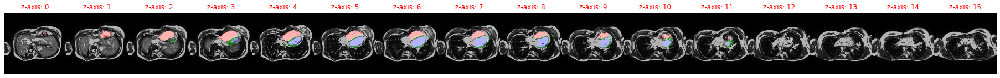

2020-06-30 08:54:38,009 INFO GT on AX


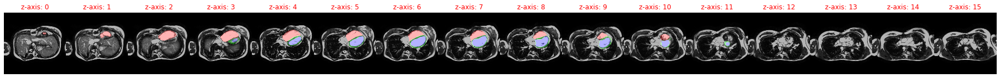

2020-06-30 08:54:38,815 INFO MSE: 0.025041740387678146
2020-06-30 08:54:38,822 INFO MSE center cube: 0.07325930893421173
2020-06-30 08:54:38,823 INFO 0000-0HQQW4ZN_2007-05-23_ES_msk.nrrd
2020-06-30 08:54:38,823 INFO Prediction on AX volume:
2020-06-30 08:54:38,823 INFO AX --> SAX rotated by the model
2020-06-30 08:54:39,076 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:54:39,773 INFO Target (SAX):
2020-06-30 08:54:39,774 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:54:41,329 INFO Predicted mask
2020-06-30 08:54:42,686 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:54:42,687 INFO Predicted mask rotated to AX on original AX image


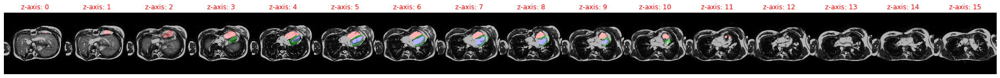

2020-06-30 08:54:43,806 INFO GT on AX


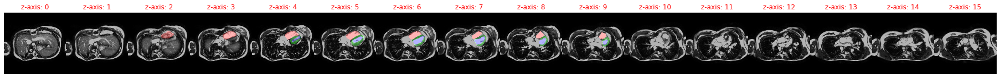

2020-06-30 08:54:44,620 INFO MSE: 0.021523362025618553
2020-06-30 08:54:44,627 INFO MSE center cube: 0.06261435896158218
2020-06-30 08:54:44,628 INFO 0000-13JLP3HN_2007-05-22_ED_msk.nrrd
2020-06-30 08:54:44,628 INFO Prediction on AX volume:
2020-06-30 08:54:44,629 INFO AX --> SAX rotated by the model
2020-06-30 08:54:44,881 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:54:45,056 INFO Target (SAX):
2020-06-30 08:54:45,056 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:54:46,480 INFO Predicted mask
2020-06-30 08:54:47,808 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:54:47,808 INFO Predicted mask rotated to AX on original AX image


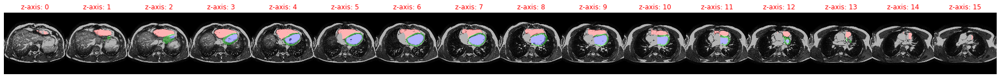

2020-06-30 08:54:48,934 INFO GT on AX


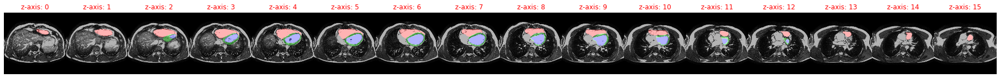

2020-06-30 08:54:49,751 INFO MSE: 0.021068336442112923
2020-06-30 08:54:49,757 INFO MSE center cube: 0.05153415724635124
2020-06-30 08:54:49,757 INFO 0000-13JLP3HN_2007-05-22_ES_msk.nrrd
2020-06-30 08:54:49,757 INFO Prediction on AX volume:
2020-06-30 08:54:49,758 INFO AX --> SAX rotated by the model
2020-06-30 08:54:50,020 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:54:50,198 INFO Target (SAX):
2020-06-30 08:54:50,198 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:54:52,657 INFO Predicted mask
2020-06-30 08:54:53,959 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:54:53,960 INFO Predicted mask rotated to AX on original AX image


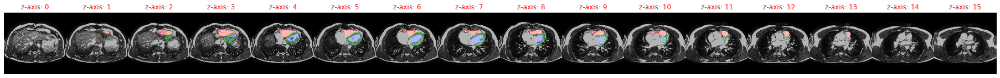

2020-06-30 08:54:55,090 INFO GT on AX


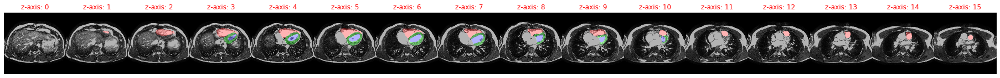

2020-06-30 08:54:55,920 INFO MSE: 0.020239489153027534
2020-06-30 08:54:55,926 INFO MSE center cube: 0.04912908375263214
2020-06-30 08:54:55,926 INFO 0000-24YLF77L_2007-11-19_ED_msk.nrrd
2020-06-30 08:54:55,927 INFO Prediction on AX volume:
2020-06-30 08:54:55,927 INFO AX --> SAX rotated by the model
2020-06-30 08:54:56,182 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:54:56,356 INFO Target (SAX):
2020-06-30 08:54:56,357 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:54:57,759 INFO Predicted mask
2020-06-30 08:54:59,044 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:54:59,045 INFO Predicted mask rotated to AX on original AX image


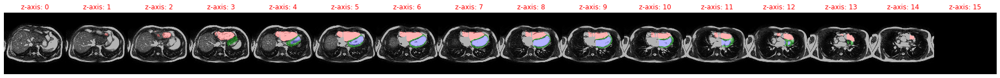

2020-06-30 08:55:00,178 INFO GT on AX


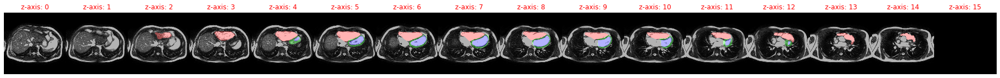

2020-06-30 08:55:00,995 INFO MSE: 0.02878393419086933
2020-06-30 08:55:01,002 INFO MSE center cube: 0.07211757451295853
2020-06-30 08:55:01,002 INFO 0000-24YLF77L_2007-11-19_ES_msk.nrrd
2020-06-30 08:55:01,003 INFO Prediction on AX volume:
2020-06-30 08:55:01,003 INFO AX --> SAX rotated by the model
2020-06-30 08:55:01,257 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:01,431 INFO Target (SAX):
2020-06-30 08:55:01,432 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:02,831 INFO Predicted mask
2020-06-30 08:55:04,135 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:04,135 INFO Predicted mask rotated to AX on original AX image


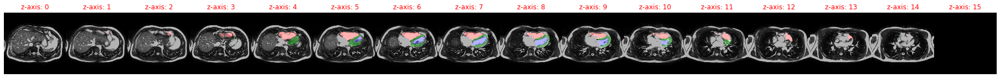

2020-06-30 08:55:05,253 INFO GT on AX


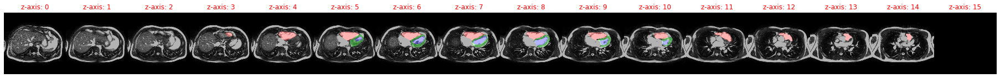

2020-06-30 08:55:06,664 INFO MSE: 0.026868849992752075
2020-06-30 08:55:06,670 INFO MSE center cube: 0.06614386290311813
2020-06-30 08:55:06,671 INFO 0000-2CVUG1C5_2006-09-06_ED_msk.nrrd
2020-06-30 08:55:06,671 INFO Prediction on AX volume:
2020-06-30 08:55:06,671 INFO AX --> SAX rotated by the model
2020-06-30 08:55:06,930 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:07,116 INFO Target (SAX):
2020-06-30 08:55:07,116 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:08,709 INFO Predicted mask
2020-06-30 08:55:10,065 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:10,065 INFO Predicted mask rotated to AX on original AX image


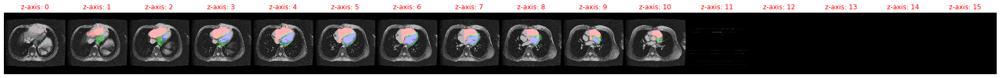

2020-06-30 08:55:11,185 INFO GT on AX


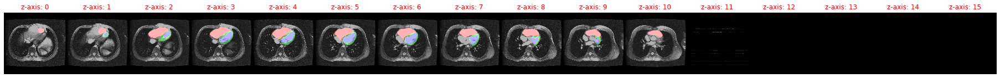

2020-06-30 08:55:12,012 INFO MSE: 0.02500012144446373
2020-06-30 08:55:12,018 INFO MSE center cube: 0.07581506669521332
2020-06-30 08:55:12,019 INFO 0000-2CVUG1C5_2006-09-06_ES_msk.nrrd
2020-06-30 08:55:12,019 INFO Prediction on AX volume:
2020-06-30 08:55:12,019 INFO AX --> SAX rotated by the model
2020-06-30 08:55:12,273 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:12,453 INFO Target (SAX):
2020-06-30 08:55:12,454 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:15,026 INFO Predicted mask
2020-06-30 08:55:16,336 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:16,336 INFO Predicted mask rotated to AX on original AX image


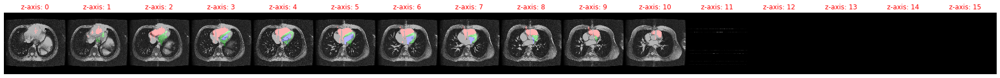

2020-06-30 08:55:17,431 INFO GT on AX


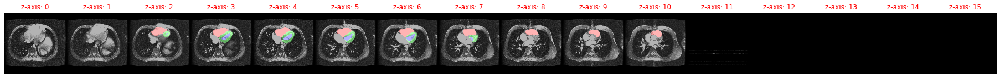

2020-06-30 08:55:18,231 INFO MSE: 0.025073403492569923
2020-06-30 08:55:18,237 INFO MSE center cube: 0.07456789165735245
2020-06-30 08:55:18,238 INFO 0000-2CW0G1A5_2006-04-06_ED_msk.nrrd
2020-06-30 08:55:18,238 INFO Prediction on AX volume:
2020-06-30 08:55:18,239 INFO AX --> SAX rotated by the model
2020-06-30 08:55:18,488 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:18,658 INFO Target (SAX):
2020-06-30 08:55:18,659 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:20,080 INFO Predicted mask
2020-06-30 08:55:21,378 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:21,379 INFO Predicted mask rotated to AX on original AX image


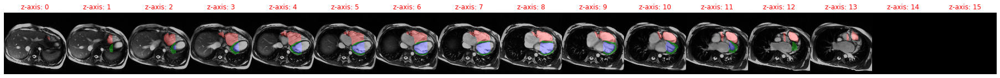

2020-06-30 08:55:22,530 INFO GT on AX


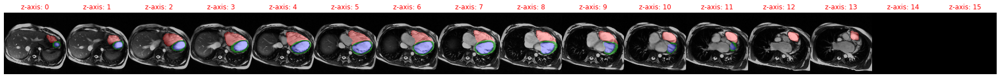

2020-06-30 08:55:23,368 INFO MSE: 0.017871394753456116
2020-06-30 08:55:23,375 INFO MSE center cube: 0.03618944063782692
2020-06-30 08:55:23,375 INFO 0000-2CW0G1A5_2006-04-06_ES_msk.nrrd
2020-06-30 08:55:23,376 INFO Prediction on AX volume:
2020-06-30 08:55:23,376 INFO AX --> SAX rotated by the model
2020-06-30 08:55:23,630 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:23,804 INFO Target (SAX):
2020-06-30 08:55:23,805 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:25,203 INFO Predicted mask
2020-06-30 08:55:26,490 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:26,491 INFO Predicted mask rotated to AX on original AX image


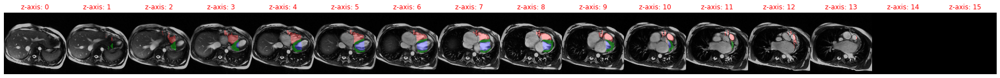

2020-06-30 08:55:27,620 INFO GT on AX


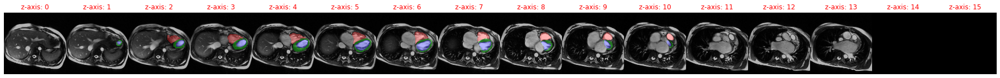

2020-06-30 08:55:28,436 INFO MSE: 0.016810838133096695
2020-06-30 08:55:28,443 INFO MSE center cube: 0.03375157341361046
2020-06-30 08:55:28,444 INFO 0000-2XRR719Z_2005-05-02_ED_msk.nrrd
2020-06-30 08:55:28,444 INFO Prediction on AX volume:
2020-06-30 08:55:28,444 INFO AX --> SAX rotated by the model
2020-06-30 08:55:28,692 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:28,861 INFO Target (SAX):
2020-06-30 08:55:28,862 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:30,250 INFO Predicted mask
2020-06-30 08:55:31,551 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:31,551 INFO Predicted mask rotated to AX on original AX image


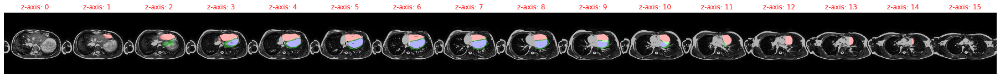

2020-06-30 08:55:33,278 INFO GT on AX


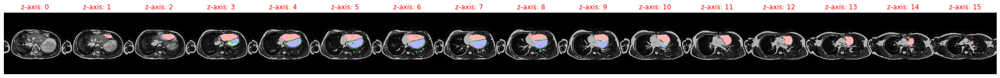

2020-06-30 08:55:34,098 INFO MSE: 0.02332353964447975
2020-06-30 08:55:34,103 INFO MSE center cube: 0.07405709475278854
2020-06-30 08:55:34,104 INFO 0000-2XRR719Z_2005-05-02_ES_msk.nrrd
2020-06-30 08:55:34,104 INFO Prediction on AX volume:
2020-06-30 08:55:34,105 INFO AX --> SAX rotated by the model
2020-06-30 08:55:34,374 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:34,558 INFO Target (SAX):
2020-06-30 08:55:34,559 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:36,007 INFO Predicted mask
2020-06-30 08:55:37,374 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:37,374 INFO Predicted mask rotated to AX on original AX image


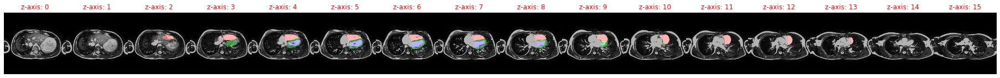

2020-06-30 08:55:38,490 INFO GT on AX


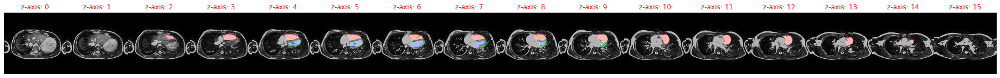

2020-06-30 08:55:39,312 INFO MSE: 0.022798338904976845
2020-06-30 08:55:39,317 INFO MSE center cube: 0.07232336699962616
2020-06-30 08:55:39,318 INFO 0000-3EX293QC_2006-06-19_ED_msk.nrrd
2020-06-30 08:55:39,318 INFO Prediction on AX volume:
2020-06-30 08:55:39,319 INFO AX --> SAX rotated by the model
2020-06-30 08:55:39,571 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:39,747 INFO Target (SAX):
2020-06-30 08:55:39,747 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:41,156 INFO Predicted mask
2020-06-30 08:55:42,464 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:42,464 INFO Predicted mask rotated to AX on original AX image


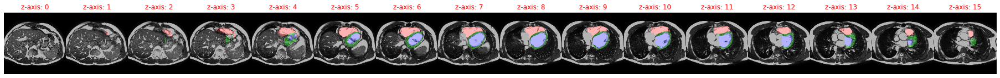

2020-06-30 08:55:43,599 INFO GT on AX


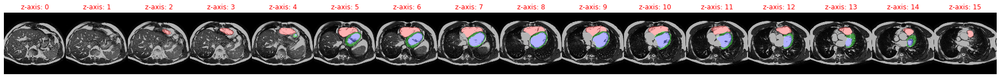

2020-06-30 08:55:44,424 INFO MSE: 0.03805844113230705
2020-06-30 08:55:44,430 INFO MSE center cube: 0.05460983142256737
2020-06-30 08:55:44,431 INFO 0000-3EX293QC_2006-06-19_ES_msk.nrrd
2020-06-30 08:55:44,431 INFO Prediction on AX volume:
2020-06-30 08:55:44,431 INFO AX --> SAX rotated by the model
2020-06-30 08:55:44,678 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:44,852 INFO Target (SAX):
2020-06-30 08:55:44,853 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:46,262 INFO Predicted mask
2020-06-30 08:55:47,545 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:47,545 INFO Predicted mask rotated to AX on original AX image


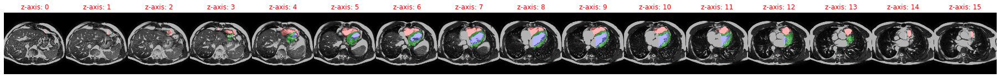

2020-06-30 08:55:48,661 INFO GT on AX


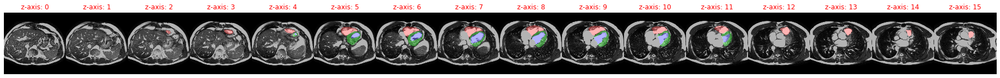

2020-06-30 08:55:49,472 INFO MSE: 0.03700102120637894
2020-06-30 08:55:49,478 INFO MSE center cube: 0.05165208876132965
2020-06-30 08:55:49,479 INFO 0000-5RMHZGWP_2006-08-03_ED_msk.nrrd
2020-06-30 08:55:49,479 INFO Prediction on AX volume:
2020-06-30 08:55:49,479 INFO AX --> SAX rotated by the model
2020-06-30 08:55:49,734 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:49,903 INFO Target (SAX):
2020-06-30 08:55:49,904 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:51,299 INFO Predicted mask
2020-06-30 08:55:52,585 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:52,585 INFO Predicted mask rotated to AX on original AX image


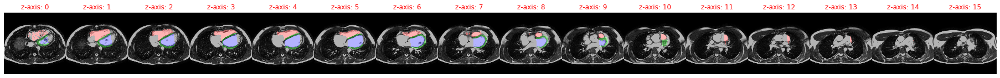

2020-06-30 08:55:53,698 INFO GT on AX


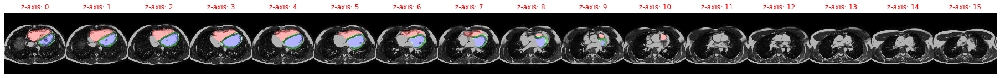

2020-06-30 08:55:54,501 INFO MSE: 0.033297646790742874
2020-06-30 08:55:54,507 INFO MSE center cube: 0.07736052572727203
2020-06-30 08:55:54,508 INFO 0000-5RMHZGWP_2006-08-03_ES_msk.nrrd
2020-06-30 08:55:54,508 INFO Prediction on AX volume:
2020-06-30 08:55:54,508 INFO AX --> SAX rotated by the model
2020-06-30 08:55:54,756 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:55:54,926 INFO Target (SAX):
2020-06-30 08:55:54,927 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:55:56,351 INFO Predicted mask
2020-06-30 08:55:57,644 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:55:57,644 INFO Predicted mask rotated to AX on original AX image


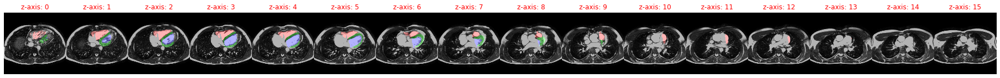

2020-06-30 08:55:58,769 INFO GT on AX


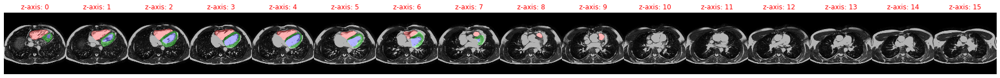

2020-06-30 08:56:00,248 INFO MSE: 0.03377099335193634
2020-06-30 08:56:00,253 INFO MSE center cube: 0.07909920811653137
2020-06-30 08:56:00,254 INFO 0000-5W8RFCJD_2005-04-18_ED_msk.nrrd
2020-06-30 08:56:00,254 INFO Prediction on AX volume:
2020-06-30 08:56:00,255 INFO AX --> SAX rotated by the model
2020-06-30 08:56:00,520 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:00,702 INFO Target (SAX):
2020-06-30 08:56:00,703 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:02,175 INFO Predicted mask
2020-06-30 08:56:03,518 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:03,519 INFO Predicted mask rotated to AX on original AX image


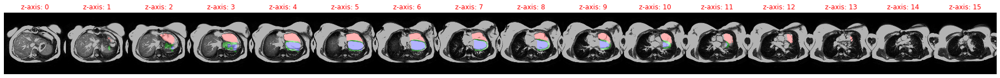

2020-06-30 08:56:04,647 INFO GT on AX


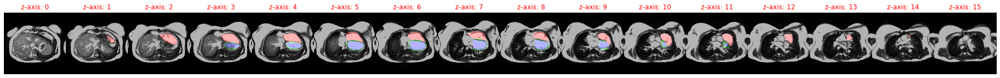

2020-06-30 08:56:05,493 INFO MSE: 0.04234059154987335
2020-06-30 08:56:05,499 INFO MSE center cube: 0.10212647169828415
2020-06-30 08:56:05,500 INFO 0000-5W8RFCJD_2005-04-18_ES_msk.nrrd
2020-06-30 08:56:05,500 INFO Prediction on AX volume:
2020-06-30 08:56:05,500 INFO AX --> SAX rotated by the model
2020-06-30 08:56:05,757 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:05,941 INFO Target (SAX):
2020-06-30 08:56:05,941 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:07,351 INFO Predicted mask
2020-06-30 08:56:09,662 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:09,663 INFO Predicted mask rotated to AX on original AX image


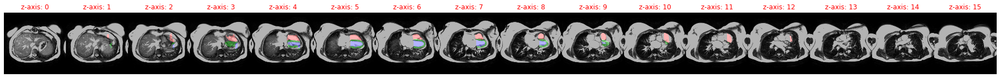

2020-06-30 08:56:10,785 INFO GT on AX


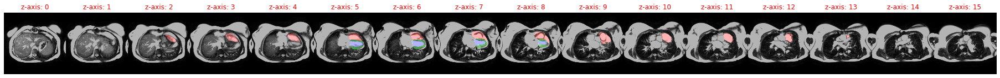

2020-06-30 08:56:11,613 INFO MSE: 0.04166058450937271
2020-06-30 08:56:11,620 INFO MSE center cube: 0.10106416791677475
2020-06-30 08:56:11,620 INFO 0000-DLTVKE94_2006-07-18_ED_msk.nrrd
2020-06-30 08:56:11,620 INFO Prediction on AX volume:
2020-06-30 08:56:11,621 INFO AX --> SAX rotated by the model
2020-06-30 08:56:11,871 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:12,049 INFO Target (SAX):
2020-06-30 08:56:12,049 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:13,445 INFO Predicted mask
2020-06-30 08:56:14,753 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:14,753 INFO Predicted mask rotated to AX on original AX image


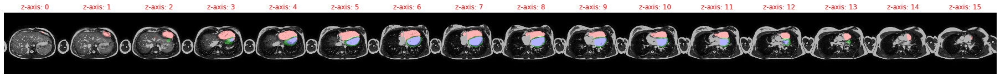

2020-06-30 08:56:15,871 INFO GT on AX


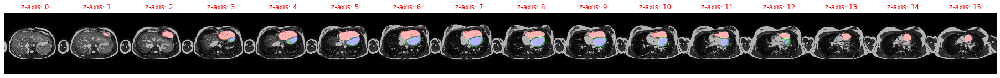

2020-06-30 08:56:16,699 INFO MSE: 0.03269549831748009
2020-06-30 08:56:16,705 INFO MSE center cube: 0.0755554661154747
2020-06-30 08:56:16,706 INFO 0000-DLTVKE94_2006-07-18_ES_msk.nrrd
2020-06-30 08:56:16,706 INFO Prediction on AX volume:
2020-06-30 08:56:16,707 INFO AX --> SAX rotated by the model
2020-06-30 08:56:16,957 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:17,126 INFO Target (SAX):
2020-06-30 08:56:17,127 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:18,519 INFO Predicted mask
2020-06-30 08:56:20,816 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:20,817 INFO Predicted mask rotated to AX on original AX image


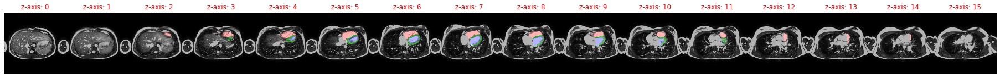

2020-06-30 08:56:21,938 INFO GT on AX


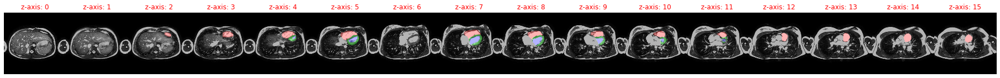

2020-06-30 08:56:22,755 INFO MSE: 0.03217635303735733
2020-06-30 08:56:22,761 INFO MSE center cube: 0.0730137899518013
2020-06-30 08:56:22,762 INFO 0000-E0RJZQQM_2005-09-30_ED_msk.nrrd
2020-06-30 08:56:22,762 INFO Prediction on AX volume:
2020-06-30 08:56:22,762 INFO AX --> SAX rotated by the model
2020-06-30 08:56:23,015 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:23,194 INFO Target (SAX):
2020-06-30 08:56:23,194 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:24,613 INFO Predicted mask
2020-06-30 08:56:25,914 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:25,914 INFO Predicted mask rotated to AX on original AX image


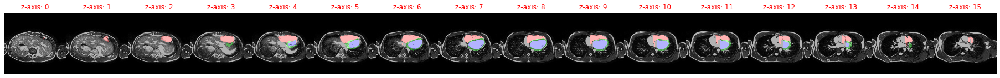

2020-06-30 08:56:27,034 INFO GT on AX


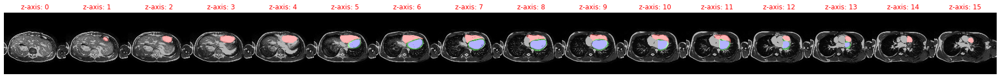

2020-06-30 08:56:28,494 INFO MSE: 0.022983884438872337
2020-06-30 08:56:28,501 INFO MSE center cube: 0.05761126056313515
2020-06-30 08:56:28,501 INFO 0000-E0RJZQQM_2005-09-30_ES_msk.nrrd
2020-06-30 08:56:28,502 INFO Prediction on AX volume:
2020-06-30 08:56:28,502 INFO AX --> SAX rotated by the model
2020-06-30 08:56:28,764 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:28,941 INFO Target (SAX):
2020-06-30 08:56:28,941 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:30,397 INFO Predicted mask
2020-06-30 08:56:31,714 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:31,715 INFO Predicted mask rotated to AX on original AX image


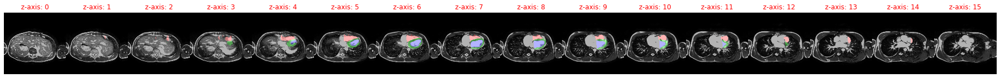

2020-06-30 08:56:32,814 INFO GT on AX


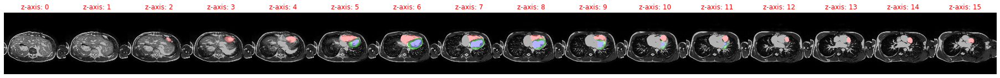

2020-06-30 08:56:33,624 INFO MSE: 0.020741332322359085
2020-06-30 08:56:33,629 INFO MSE center cube: 0.05208921805024147
2020-06-30 08:56:33,630 INFO 0000-E24LRCWD_2006-11-23_ED_msk.nrrd
2020-06-30 08:56:33,630 INFO Prediction on AX volume:
2020-06-30 08:56:33,631 INFO AX --> SAX rotated by the model
2020-06-30 08:56:33,875 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:34,047 INFO Target (SAX):
2020-06-30 08:56:34,047 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:35,465 INFO Predicted mask
2020-06-30 08:56:36,776 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:36,776 INFO Predicted mask rotated to AX on original AX image


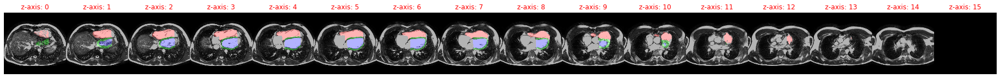

2020-06-30 08:56:37,884 INFO GT on AX


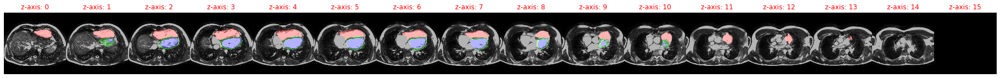

2020-06-30 08:56:38,694 INFO MSE: 0.023104196414351463
2020-06-30 08:56:38,699 INFO MSE center cube: 0.057191696017980576
2020-06-30 08:56:38,700 INFO 0000-E24LRCWD_2006-11-23_ES_msk.nrrd
2020-06-30 08:56:38,700 INFO Prediction on AX volume:
2020-06-30 08:56:38,700 INFO AX --> SAX rotated by the model
2020-06-30 08:56:38,949 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:39,118 INFO Target (SAX):
2020-06-30 08:56:39,119 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:40,518 INFO Predicted mask
2020-06-30 08:56:41,801 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:41,801 INFO Predicted mask rotated to AX on original AX image


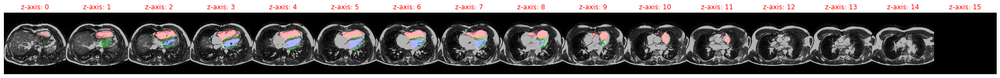

2020-06-30 08:56:42,905 INFO GT on AX


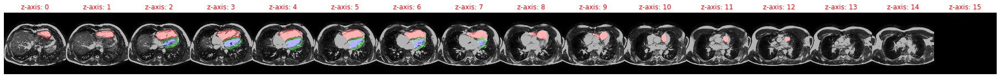

2020-06-30 08:56:43,718 INFO MSE: 0.022173907607793808
2020-06-30 08:56:43,724 INFO MSE center cube: 0.05531461164355278
2020-06-30 08:56:43,724 INFO 0000-FANDNZ55_2007-02-19_ED_msk.nrrd
2020-06-30 08:56:43,725 INFO Prediction on AX volume:
2020-06-30 08:56:43,725 INFO AX --> SAX rotated by the model
2020-06-30 08:56:43,972 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:44,142 INFO Target (SAX):
2020-06-30 08:56:44,142 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:46,570 INFO Predicted mask
2020-06-30 08:56:47,932 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:47,932 INFO Predicted mask rotated to AX on original AX image


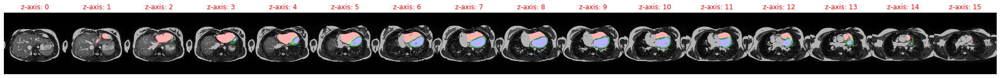

2020-06-30 08:56:49,032 INFO GT on AX


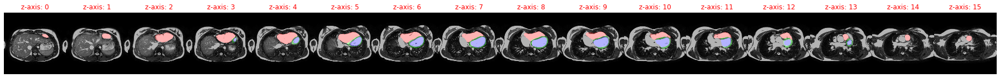

2020-06-30 08:56:49,834 INFO MSE: 0.022983722388744354
2020-06-30 08:56:49,840 INFO MSE center cube: 0.04473133757710457
2020-06-30 08:56:49,841 INFO 0000-FANDNZ55_2007-02-19_ES_msk.nrrd
2020-06-30 08:56:49,841 INFO Prediction on AX volume:
2020-06-30 08:56:49,841 INFO AX --> SAX rotated by the model
2020-06-30 08:56:50,091 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:50,260 INFO Target (SAX):
2020-06-30 08:56:50,260 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:51,661 INFO Predicted mask
2020-06-30 08:56:52,959 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:52,959 INFO Predicted mask rotated to AX on original AX image


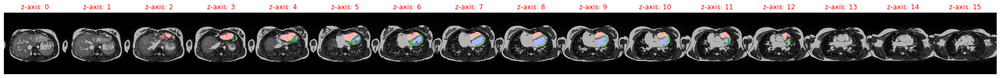

2020-06-30 08:56:54,085 INFO GT on AX


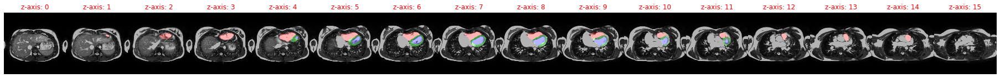

2020-06-30 08:56:54,905 INFO MSE: 0.023850752040743828
2020-06-30 08:56:54,912 INFO MSE center cube: 0.047938648611307144
2020-06-30 08:56:54,912 INFO 0000-FHQU30DQ_2005-05-10_ED_msk.nrrd
2020-06-30 08:56:54,913 INFO Prediction on AX volume:
2020-06-30 08:56:54,913 INFO AX --> SAX rotated by the model
2020-06-30 08:56:55,165 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:56:55,337 INFO Target (SAX):
2020-06-30 08:56:55,338 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:56:57,541 INFO Predicted mask
2020-06-30 08:56:58,916 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:56:58,916 INFO Predicted mask rotated to AX on original AX image


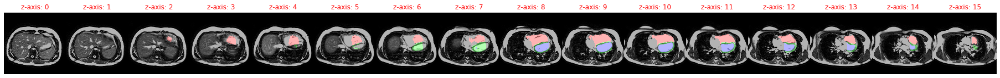

2020-06-30 08:57:00,039 INFO GT on AX


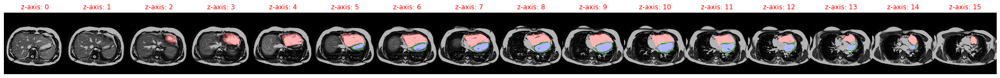

2020-06-30 08:57:00,861 INFO MSE: 0.01970500685274601
2020-06-30 08:57:00,867 INFO MSE center cube: 0.03719129413366318
2020-06-30 08:57:00,867 INFO 0000-FHQU30DQ_2005-05-10_ES_msk.nrrd
2020-06-30 08:57:00,868 INFO Prediction on AX volume:
2020-06-30 08:57:00,868 INFO AX --> SAX rotated by the model
2020-06-30 08:57:01,124 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:01,296 INFO Target (SAX):
2020-06-30 08:57:01,296 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:02,708 INFO Predicted mask
2020-06-30 08:57:04,011 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:04,011 INFO Predicted mask rotated to AX on original AX image


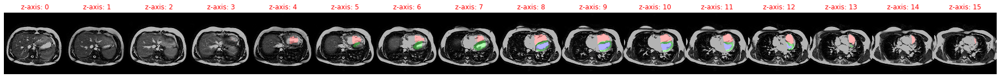

2020-06-30 08:57:05,146 INFO GT on AX


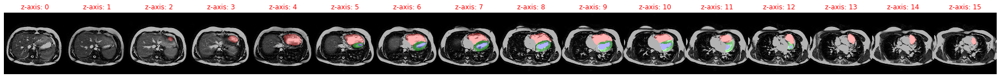

2020-06-30 08:57:05,968 INFO MSE: 0.020076125860214233
2020-06-30 08:57:05,973 INFO MSE center cube: 0.03942400962114334
2020-06-30 08:57:05,974 INFO 0000-G8XJ03CH_2007-10-31_ED_msk.nrrd
2020-06-30 08:57:05,974 INFO Prediction on AX volume:
2020-06-30 08:57:05,975 INFO AX --> SAX rotated by the model
2020-06-30 08:57:06,223 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:06,397 INFO Target (SAX):
2020-06-30 08:57:06,398 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:07,815 INFO Predicted mask
2020-06-30 08:57:09,111 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:09,112 INFO Predicted mask rotated to AX on original AX image


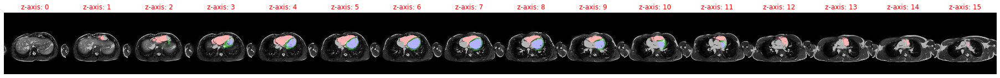

2020-06-30 08:57:10,237 INFO GT on AX


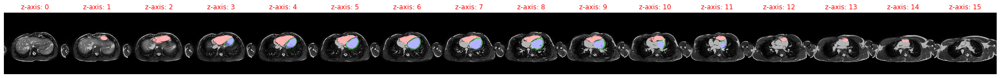

2020-06-30 08:57:11,032 INFO MSE: 0.016879431903362274
2020-06-30 08:57:11,039 INFO MSE center cube: 0.04156011715531349
2020-06-30 08:57:11,039 INFO 0000-G8XJ03CH_2007-10-31_ES_msk.nrrd
2020-06-30 08:57:11,040 INFO Prediction on AX volume:
2020-06-30 08:57:11,041 INFO AX --> SAX rotated by the model
2020-06-30 08:57:11,289 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:11,459 INFO Target (SAX):
2020-06-30 08:57:11,459 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:12,848 INFO Predicted mask
2020-06-30 08:57:14,138 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:14,139 INFO Predicted mask rotated to AX on original AX image


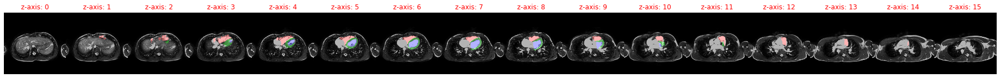

2020-06-30 08:57:15,244 INFO GT on AX


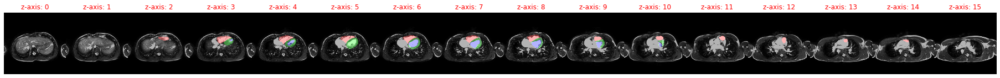

2020-06-30 08:57:16,047 INFO MSE: 0.014766943641006947
2020-06-30 08:57:16,053 INFO MSE center cube: 0.03687768429517746
2020-06-30 08:57:16,054 INFO 0000-GYMP57R6_2006-12-18_ED_msk.nrrd
2020-06-30 08:57:16,054 INFO Prediction on AX volume:
2020-06-30 08:57:16,055 INFO AX --> SAX rotated by the model
2020-06-30 08:57:16,304 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:16,476 INFO Target (SAX):
2020-06-30 08:57:16,477 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:17,867 INFO Predicted mask
2020-06-30 08:57:19,147 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:19,147 INFO Predicted mask rotated to AX on original AX image


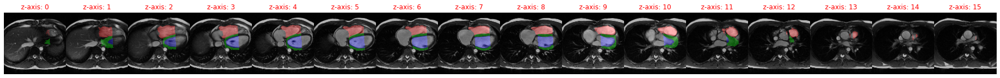

2020-06-30 08:57:20,270 INFO GT on AX


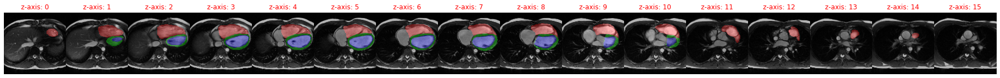

2020-06-30 08:57:21,089 INFO MSE: 0.017507072538137436
2020-06-30 08:57:21,095 INFO MSE center cube: 0.02072160504758358
2020-06-30 08:57:21,096 INFO 0000-GYMP57R6_2006-12-18_ES_msk.nrrd
2020-06-30 08:57:21,096 INFO Prediction on AX volume:
2020-06-30 08:57:21,097 INFO AX --> SAX rotated by the model
2020-06-30 08:57:21,345 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:21,519 INFO Target (SAX):
2020-06-30 08:57:21,519 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:22,921 INFO Predicted mask
2020-06-30 08:57:24,980 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:24,980 INFO Predicted mask rotated to AX on original AX image


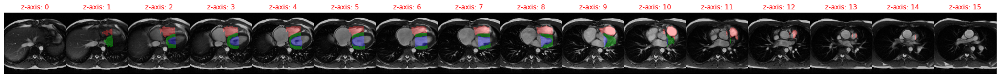

2020-06-30 08:57:26,124 INFO GT on AX


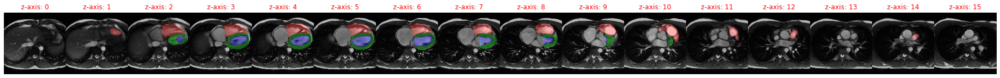

2020-06-30 08:57:26,962 INFO MSE: 0.018431106582283974
2020-06-30 08:57:26,967 INFO MSE center cube: 0.021231910213828087
2020-06-30 08:57:26,968 INFO 0000-GYRF6ZAA_2004-08-01_ED_msk.nrrd
2020-06-30 08:57:26,968 INFO Prediction on AX volume:
2020-06-30 08:57:26,968 INFO AX --> SAX rotated by the model
2020-06-30 08:57:27,225 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:27,403 INFO Target (SAX):
2020-06-30 08:57:27,404 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:28,817 INFO Predicted mask
2020-06-30 08:57:30,130 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:30,131 INFO Predicted mask rotated to AX on original AX image


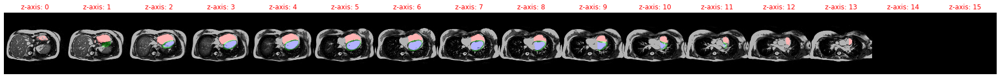

2020-06-30 08:57:31,232 INFO GT on AX


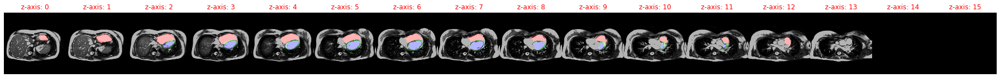

2020-06-30 08:57:32,029 INFO MSE: 0.017628785222768784
2020-06-30 08:57:32,034 INFO MSE center cube: 0.05413929000496864
2020-06-30 08:57:32,035 INFO 0000-GYRF6ZAA_2004-08-01_ES_msk.nrrd
2020-06-30 08:57:32,035 INFO Prediction on AX volume:
2020-06-30 08:57:32,036 INFO AX --> SAX rotated by the model
2020-06-30 08:57:32,291 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:32,465 INFO Target (SAX):
2020-06-30 08:57:32,465 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:33,862 INFO Predicted mask
2020-06-30 08:57:35,153 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:35,154 INFO Predicted mask rotated to AX on original AX image


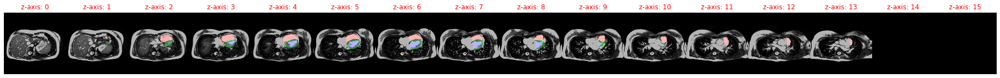

2020-06-30 08:57:36,267 INFO GT on AX


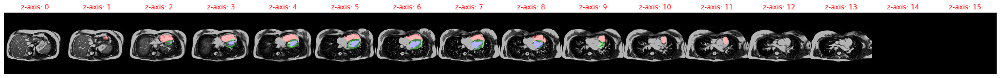

2020-06-30 08:57:37,068 INFO MSE: 0.016520293429493904
2020-06-30 08:57:37,074 INFO MSE center cube: 0.050777364522218704
2020-06-30 08:57:37,075 INFO 0000-JDRPF7F4_2006-02-28_ED_msk.nrrd
2020-06-30 08:57:37,075 INFO Prediction on AX volume:
2020-06-30 08:57:37,076 INFO AX --> SAX rotated by the model
2020-06-30 08:57:37,323 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:37,492 INFO Target (SAX):
2020-06-30 08:57:37,493 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:38,921 INFO Predicted mask
2020-06-30 08:57:40,202 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:40,202 INFO Predicted mask rotated to AX on original AX image


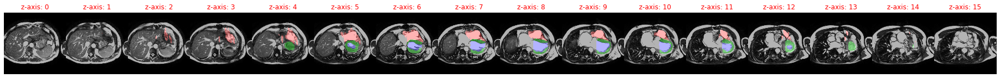

2020-06-30 08:57:41,345 INFO GT on AX


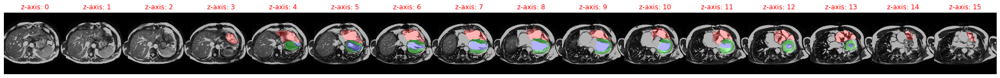

2020-06-30 08:57:42,180 INFO MSE: 0.02928313799202442
2020-06-30 08:57:42,186 INFO MSE center cube: 0.06054960563778877
2020-06-30 08:57:42,187 INFO 0000-JDRPF7F4_2006-02-28_ES_msk.nrrd
2020-06-30 08:57:42,187 INFO Prediction on AX volume:
2020-06-30 08:57:42,188 INFO AX --> SAX rotated by the model
2020-06-30 08:57:42,442 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:42,616 INFO Target (SAX):
2020-06-30 08:57:42,616 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:44,040 INFO Predicted mask
2020-06-30 08:57:45,321 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:45,322 INFO Predicted mask rotated to AX on original AX image


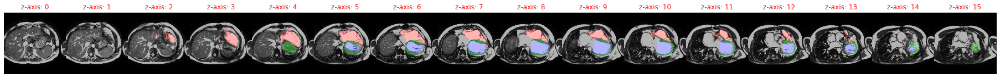

2020-06-30 08:57:46,474 INFO GT on AX


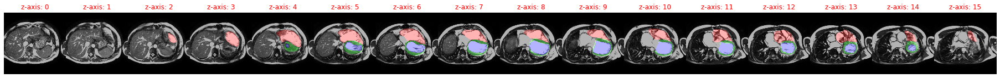

2020-06-30 08:57:47,301 INFO MSE: 0.03072921372950077
2020-06-30 08:57:47,308 INFO MSE center cube: 0.0803036019206047
2020-06-30 08:57:47,308 INFO 0000-JP6XAZWH_2007-03-02_ED_msk.nrrd
2020-06-30 08:57:47,309 INFO Prediction on AX volume:
2020-06-30 08:57:47,309 INFO AX --> SAX rotated by the model
2020-06-30 08:57:47,557 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:47,730 INFO Target (SAX):
2020-06-30 08:57:47,730 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:49,164 INFO Predicted mask
2020-06-30 08:57:50,473 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:50,474 INFO Predicted mask rotated to AX on original AX image


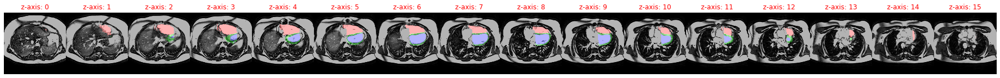

2020-06-30 08:57:51,620 INFO GT on AX


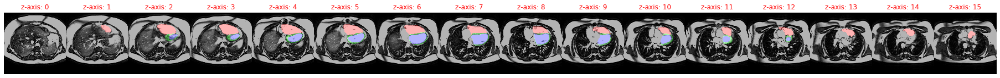

2020-06-30 08:57:53,181 INFO MSE: 0.04986652731895447
2020-06-30 08:57:53,187 INFO MSE center cube: 0.0742984265089035
2020-06-30 08:57:53,188 INFO 0000-JP6XAZWH_2007-03-02_ES_msk.nrrd
2020-06-30 08:57:53,188 INFO Prediction on AX volume:
2020-06-30 08:57:53,188 INFO AX --> SAX rotated by the model
2020-06-30 08:57:53,486 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:53,677 INFO Target (SAX):
2020-06-30 08:57:53,678 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:57:55,231 INFO Predicted mask
2020-06-30 08:57:56,548 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:57:56,549 INFO Predicted mask rotated to AX on original AX image


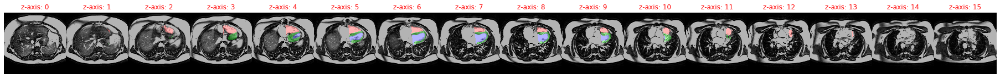

2020-06-30 08:57:57,663 INFO GT on AX


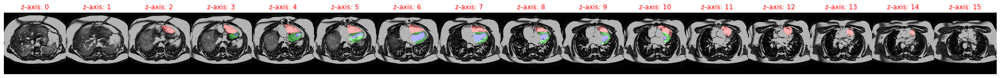

2020-06-30 08:57:58,486 INFO MSE: 0.04569048434495926
2020-06-30 08:57:58,492 INFO MSE center cube: 0.06709953397512436
2020-06-30 08:57:58,492 INFO 0000-K4HCL72E_2007-03-27_ED_msk.nrrd
2020-06-30 08:57:58,492 INFO Prediction on AX volume:
2020-06-30 08:57:58,493 INFO AX --> SAX rotated by the model
2020-06-30 08:57:58,748 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:57:58,919 INFO Target (SAX):
2020-06-30 08:57:58,920 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:58:01,431 INFO Predicted mask
2020-06-30 08:58:02,732 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:58:02,732 INFO Predicted mask rotated to AX on original AX image


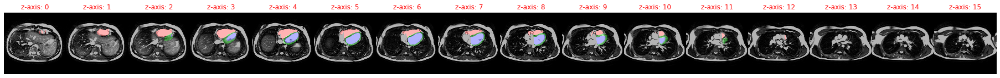

2020-06-30 08:58:03,858 INFO GT on AX


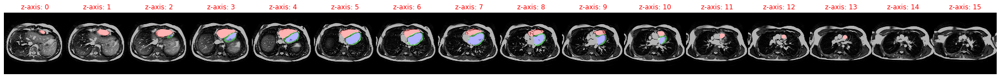

2020-06-30 08:58:04,684 INFO MSE: 0.030116472393274307
2020-06-30 08:58:04,689 INFO MSE center cube: 0.07426657527685165
2020-06-30 08:58:04,690 INFO 0000-K4HCL72E_2007-03-27_ES_msk.nrrd
2020-06-30 08:58:04,690 INFO Prediction on AX volume:
2020-06-30 08:58:04,690 INFO AX --> SAX rotated by the model
2020-06-30 08:58:04,941 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:58:05,116 INFO Target (SAX):
2020-06-30 08:58:05,117 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:58:06,551 INFO Predicted mask
2020-06-30 08:58:08,854 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:58:08,855 INFO Predicted mask rotated to AX on original AX image


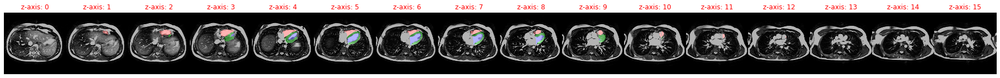

2020-06-30 08:58:09,976 INFO GT on AX


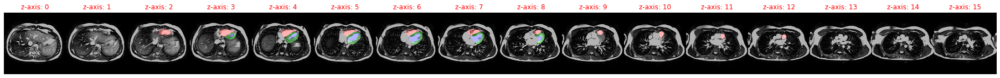

2020-06-30 08:58:10,804 INFO MSE: 0.02736281417310238
2020-06-30 08:58:10,810 INFO MSE center cube: 0.06641307473182678
2020-06-30 08:58:10,810 INFO 0000-K61NJJ2D_2007-05-29_ED_msk.nrrd
2020-06-30 08:58:10,810 INFO Prediction on AX volume:
2020-06-30 08:58:10,811 INFO AX --> SAX rotated by the model
2020-06-30 08:58:11,081 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:58:11,255 INFO Target (SAX):
2020-06-30 08:58:11,256 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:58:12,711 INFO Predicted mask
2020-06-30 08:58:13,995 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:58:13,995 INFO Predicted mask rotated to AX on original AX image


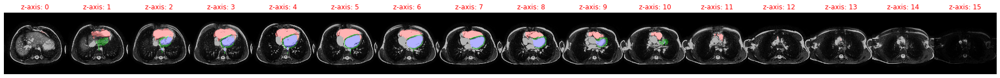

2020-06-30 08:58:15,101 INFO GT on AX


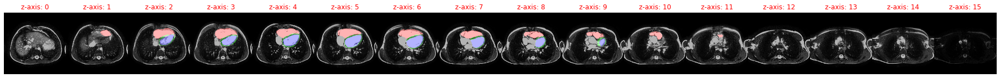

2020-06-30 08:58:15,908 INFO MSE: 0.015578975901007652
2020-06-30 08:58:15,914 INFO MSE center cube: 0.0456453412771225
2020-06-30 08:58:15,915 INFO 0000-K61NJJ2D_2007-05-29_ES_msk.nrrd
2020-06-30 08:58:15,915 INFO Prediction on AX volume:
2020-06-30 08:58:15,916 INFO AX --> SAX rotated by the model
2020-06-30 08:58:16,165 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
2020-06-30 08:58:16,333 INFO Target (SAX):
2020-06-30 08:58:16,333 INFO Apply the invers rotation to our AXtoSAX
2020-06-30 08:58:17,739 INFO Predicted mask
2020-06-30 08:58:19,040 INFO Predicted mask rotated to AX on inverse AXtoSAX
2020-06-30 08:58:19,040 INFO Predicted mask rotated to AX on original AX image


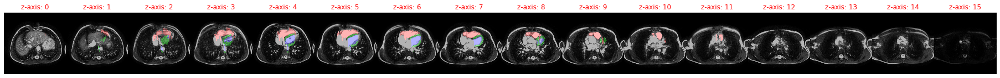

2020-06-30 08:58:20,164 INFO GT on AX


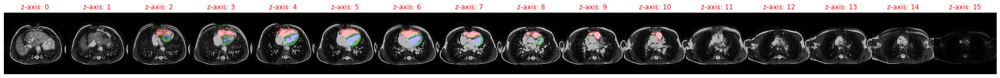

2020-06-30 08:58:20,983 INFO MSE: 0.01399427279829979
2020-06-30 08:58:20,989 INFO MSE center cube: 0.04086796194314957


In [23]:
shift_z = 10
path_ = 'data/predicted/AX_to_SAX_to_AX_finetune_first20z_margin_50/3D/'
for i in range(x_.shape[0]):
    select_image_in_batch(im=i,slice_n=5, debug=False,shift_z=shift_z, export_path=path_, save=True)

In [69]:
# check the memory usage
import sys

# These are the usual ipython objects, including this one you are creating
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)


[('ax_msk__', 2697461920),
 ('sax_msk_', 2697461920),
 ('x_', 674365600),
 ('y_', 674365600),
 ('cfg', 2280),
 ('config', 2280),
 ('config_temp', 2280),
 ('msk_cfg', 2280),
 ('DataGenerator', 2000),
 ('MotionDataGenerator', 2000),
 ('x_train_ax', 1192),
 ('x_train_sax', 1192),
 ('y_train_ax', 1192),
 ('y_train_sax', 1192),
 ('Console_and_file_logger', 1056),
 ('Counter', 1056),
 ('InteractiveShell', 1056),
 ('LazyImport', 1056),
 ('FileChooser', 888),
 ('x_val_ax', 488),
 ('x_val_sax', 488),
 ('y_val_ax', 488),
 ('y_val_sax', 488),
 ('s', 368),
 ('info', 240),
 ('data_file', 216),
 ('config_file', 138),
 ('LOSS_FUNCTION', 136),
 ('active_imports', 136),
 ('change_wd_to_project_root', 136),
 ('choose_gpu_by_id', 136),
 ('clean_3d_prediction_3d_cc', 136),
 ('copy_meta_and_save', 136),
 ('create_affine_transformer_fixed', 136),
 ('cube_loss', 136),
 ('ensure_dir', 136),
 ('from_channel_to_flat', 136),
 ('get_callbacks', 136),
 ('get_img_msk_files_from_split_dir', 136),
 ('get_model', 136)

In [16]:
# Load a previous config and by this a pre-trained model
from ipyfilechooser import FileChooser
config_chooser = FileChooser(os.path.join(os.getcwd(),'reports/configs'), 'config.json')
display(config_chooser) # 3D/wrapper/fold1/last

FileChooser(path='/mnt/data/git/cardio/reports/configs', filename='config.json', show_hidden='False')

In [19]:
"""
load past config for model training 
"""
if tf.distribute.has_strategy():
    strategy = tf.distribute.get_strategy()
else:
    # distribute the training with the mirrored data paradigm across multiple gpus if available, if not use gpu 0
    strategy = tf.distribute.MirroredStrategy(devices=config.get('GPUS', ["/gpu:0"]))
tf.print('Number of devices: {}'.format(strategy.num_replicas_in_sync))
if config_chooser:
    config_file  = config_chooser.selected
#config_file = 'reports/configs/2D/acdc/cv/fold3/2020-05-12_22_54/config.json'
load = True # change to false, if this pipeline is used without finetuning
# load config with all params into global namespace
from src.models.Unets import load_pretrained_model
if load: # load pretrained model
    with open(config_file, encoding='utf-8') as data_file:
        config_temp = json.loads(data_file.read())
    config_temp['LOSS_FUNCTION'] = config['LOSS_FUNCTION']
    logging.info('Load model from Experiment: {}'.format(config_temp['EXPERIMENT']))
    #logging.info('config:\n {}'.format(json.dumps(config, indent=4, sort_keys=True)))

    try:
        with strategy.scope():
            globals()['unet'] = load_pretrained_model(config_temp, metrics, comp=False,multigpu=False)
            globals()['unet'].summary()
    except Exception as e:
        logging.error(str(e))

Number of devices: 2
Model: "pretrained-2D-wrapper"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 80, 224, 224 0                                            
__________________________________________________________________________________________________
tf_op_layer_unstack (TensorFlow [(None, 224, 224, 1) 0           input_1[0][0]                    
__________________________________________________________________________________________________
unet (Functional)               (None, 224, 224, 4)  8641796     tf_op_layer_unstack[0][68]       
                                                                 tf_op_layer_unstack[0][35]       
                                                                 tf_op_layer_unstack[0][66]       
                                                         